# Merged hit timing in the GlueX forward time-of-flight detector: before TOF timing fix 3-2024
This study is in response to the discussion of issue #780 on https://github.com/JeffersonLab/halld_recon. In that exchange, on March 19 Justin Stevens posted the following pair of plots demonstrating a clear mismatch between the shapes of the timing distributions for charged pions in real data compared with simulation (hdgeant4).
<div>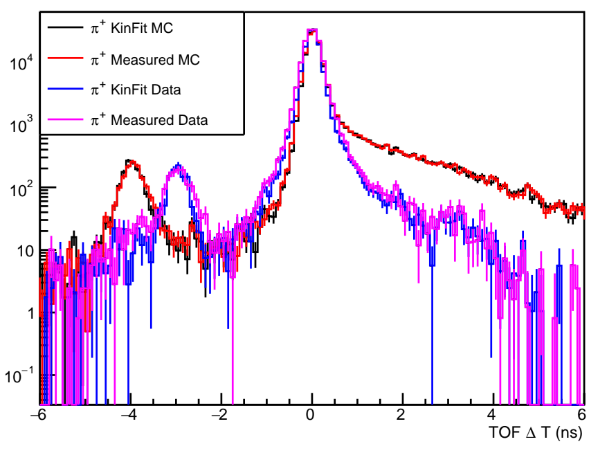
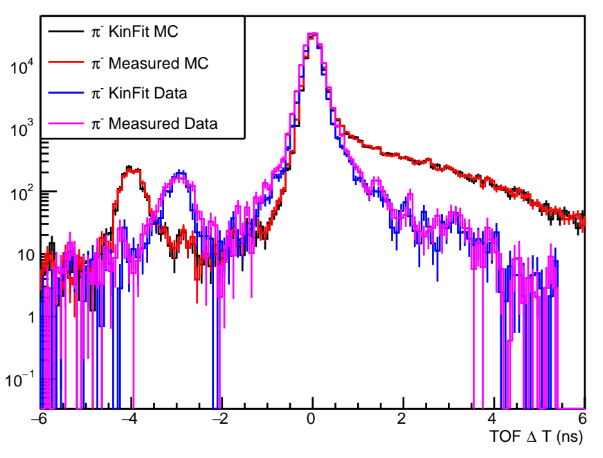</div>
Follow-up results presented under discussion of this issue showed convincingly that this long tail to late times was associated with the choice of hits merging algorithm in the scintillators of the FTOF, in which all hits in a particular paddle end that occur within a pulse-width time window are merged into a single pulse by adding their pulse amplitudes and sssigning an energy-weighted average to their pulse times. Replacing this energy-weighted average time with the time of the earliest pulse-let within an aggregated pulse seems to get rid of this tail to late times seen in the above plots for Monte Carlo events, leading to a much better agreement for these timing distributions between simulation and real data. This raises some questions that I investigate below.

1. Are there significant numbers of late after-pulses within the two-pulse resolution window that lead to these late hits in simulation?
2. What is the origin of these after-pulses? What kinds of particles are responsible for them?
3. Are they associated with the original track, or is it some other particle, eg. backsplash from the FCAL that produces these after-pulses?
4. Is there something about the FTOF geometry that makes it particularly sensitive to after-pulses, or is this effect expected to impact the calorimeters as well? start counter?

In [1]:
%pip install "gluex.hddm_s>=2.2.1"
from gluex import hddm_s
from gluex import xrootd_client as xclient
import ROOT
%jsroot on
import sys
import os
import re
import math

Defaulting to user installation because normal site-packages is not writeable
distutils: /srv/.local/lib/python3.9/site-packages
sysconfig: /srv/.local/lib64/python3.9/site-packages
user = True
home = None
root = None
prefix = None
Note: you may need to restart the kernel to use updated packages.


In [2]:
unique_names = {}
def get_unique_name(prefix):
    suffix = 0
    while f"{prefix}{suffix}" in unique_names:
        suffix += 1
    unique_name = f"{prefix}{suffix}"
    unique_names[unique_name] = 1
    return unique_name

canvases = []
def hdraw(h1d, xrange=None,
               yrange=None,
               logx=False,
               logy=False,
               width=500,
               height=400,
               opt=''):
    """
    Draws a ROOT.TH1 histogram in a jupyter notebook graphic, with user options.
    """
    cname = get_unique_name("c")
    canv = ROOT.TCanvas(cname, cname, width, height)
    if logx:
        canv.SetLogx(1)
    else:
        canv.SetLogx(0)
    if logy:
        canv.SetLogy(1)
    else:
        canv.SetLogy(0)
    if xrange:
        h1d.GetXaxis().SetRangeUser(*xrange)
    if yrange:
        h1d.GetYaxis().SetRangeUser(*yrange)
    canv.cd()
    h1d.Draw(opt)
    print("drawing on canvas", canv.GetName())
    canv.Draw()
    canvases.append(canv)

In [3]:
def hdraw2(h1ds, xrange=None,
                 yrange=None,
                 logx=False,
                 logy=False,
                 width=500,
                 height=400,
                 nwide=2,
                 opt=''):
    """
    Draws a list of ROOT.TH1 histograms in a jupyter notebook graphic, with user options.
    """
    cname = get_unique_name("c")
    nhigh = (len(h1ds) + nwide - 1) // nwide
    canv = ROOT.TCanvas(cname, cname, width, height)
    canv.Divide(nwide, nhigh)
    for ipad in range(len(h1ds)):
        h1d = h1ds[ipad]
        pad = canv.cd(ipad + 1)
        if logx and logx[ipad]:
            pad.SetLogx(1)
        else:
            pad.SetLogx(0)
        if logy and logy[ipad]:
            pad.SetLogy(1)
        else:
            pad.SetLogy(0)
        h1d.Draw(opt)
        if xrange and xrange[ipad]:
            h1d.GetXaxis().SetRangeUser(*(xrange[ipad]))
        if yrange and yrange[ipad]:
            h1d.GetYaxis().SetRangeUser(*(yrange[ipad]))
        h1d.Draw(opt)
        canvases.append(pad)
    canv.cd(0)
    canv.Draw()
    print("drawing on canvas", canv.GetName())
    canvases.append(canv)

## Estimating the geometric time of flight resolution of the FTOF
The starting point for this study is a measurement of the baseline hit-level time resolution of the FTOF coming out of hdgeant4. This measurement is done using the -nosemar data which was generated by hdgeant4 back in January, 2023 so using the original hits merging algorithm. To get started, I am going to make unrestricted use of truth hits data to correct the measured time for vertex and track kinematics to put all times into a single narrow peak.

In [4]:
xserver = "root://nod25.phys.uconn.edu"
nosmears = "/Gluex/simulation/simsamples/particle_gun-nosmear"
nomerges = "/Gluex/simulation/simsamples/particle_gun-nomergehits"
postfixes = "/Gluex/simulation/simsamples/particle_gun-v5.14.2"

piplus12 = re.compile("particle_gun012_([0-9]*)_smeared.hddm")
piminus12 = re.compile("particle_gun014_([0-9]*)_smeared.hddm")

In [5]:
clight = 30 # cm/ns
clight_bar = 15 # cm/ns
halflen_bar = 126 # cm
attenlength = 150 # cm
min_deltat = 25 # ns
dEthreshold = 0 # GeV
maxPiEloss = 0.1 # GeV

hmult = ROOT.TH1D("hmult", "hit multiplicity (left or right)", 100, 0, 100)
hmult.GetXaxis().SetTitle("hit multiplicity")
hmult.GetYaxis().SetTitle("counts")
hdeltaE = ROOT.TH1D("hdeltaE", "pulse height at the phototube", 200, -5, 0.)
hdeltaE.GetXaxis().SetTitle("log(#Delta E/GeV) with attenuation (GeV)")
hdeltaE.GetYaxis().SetTitle("counts")
htime = ROOT.TH1D("htime", "pulse time at the phototube", 1000, 0, 100)
htime.GetXaxis().SetTitle("pulse time/ns)")
htime.GetYaxis().SetTitle("counts")
htime2 = ROOT.TH2D("htime2", "time of flight * v[z] for pi", 50000, 0, 100, 100, 0, 12)
htime2.GetXaxis().SetTitle("time of flight/ns)")
htime2.GetYaxis().SetTitle("pion momentum/GeV")
hbgtype = ROOT.TH1D("hbgtype", "particle type of non-primaries that make TOF hits", 100, 0, 100)
hbgtype.GetXaxis().SetTitle("G3 particle code")
hbgtype.GetYaxis().SetTitle("counts")

hists = [hmult, hdeltaE, htime, htime2, hbgtype]

In [6]:
rootsaved = "ftof_timing.root"
if not os.path.isfile(rootsaved):
    with ROOT.TFile(rootsaved, "recreate") as fsave:
        print(f"fresh instance of {rootsaved} created.")

def hclones(hprotos, hnames):
    clones = {}
    try:
        with ROOT.TFile(rootsaved, "read") as fsave:
            for hproto,hname in zip(hprotos, hnames):
                pname = hproto.GetName()
                clones[pname] = fsave.Get(hname)
                clones[pname].SetDirectory(0)
    except:
        for hproto,hname in zip(hprotos, hnames):
            pname = hproto.GetName()
            clones[pname] = hproto.Clone(hname)
            clones[pname].SetDirectory(0)
    return clones

fresh instance of ftof_timing.root created.


In [7]:
hpions = hclones(hists, [h.GetName() + "_pions" for h in hists])
if hpions['hmult'].GetEntries() == 0:
    print("saved histograms not found, regenerating...")
    maxevents = 1000000
    evcount = 0
    xfs = xclient.FileSystem(xserver)
    status,nosmearfiles = xfs.dirlist(nosmears)
    for fin in nosmearfiles['dirlist']:
        if piplus12.match(fin['name']):
            for rec in hddm_s.istream(xserver + nosmears + '/' + fin['name']):
                ori = rec.getOrigins()
                mom = rec.getMomenta()
                for ctr in rec.getFtofCounters():
                    mult = [0,0]
                    E_pion = 0
                    pz_pion = -1
                    bgtype = 0
                    bar_propagation_delay = 0
                    for hit in ctr.getFtofTruthHits():
                        for xtra in hit.getFtofTruthExtras():
                            if (xtra.ptype == 8 or xtra.ptype == 9) and xtra.itrack == 1:
                                if hit.end == 0:
                                    bar_propagation_delay = (halflen_bar - xtra.dist) / clight_bar
                                else:
                                    bar_propagation_delay = (halflen_bar + xtra.dist) / clight_bar
                                if xtra.E < mom[0].E and xtra.E > mom[0].E - maxPiEloss:
                                    pz_pion = xtra.pz
                                    E_pion = xtra.E
                                    zplane = xtra.z - 610
                                elif xtra.E > mom[0].E:
                                    bgtype = 90
                                else:
                                    bgtype = 99
                            else:
                                bgtype = xtra.ptype
                        if hit.dE > dEthreshold and E_pion > 0 and bgtype == 0:
                            hpions['hdeltaE'].Fill(math.log(hit.dE) / math.log(10))
                            tof = hit.t - bar_propagation_delay + ori[0].vz / clight
                            tofz = tof * pz_pion / E_pion
                            tofz -= zplane / clight
                            hpions['htime'].Fill(tof)
                            hpions['htime2'].Fill(tofz, pz_pion)
                            mult[hit.end] += 1
                        else:
                            hpions['hbgtype'].Fill(bgtype)
                    hpions['hmult'].Fill(mult[0])
                    hpions['hmult'].Fill(mult[1])
                evcount += 1
                if evcount >= maxevents:
                   break
        if evcount >= maxevents:
            break
    print("saving regenerated histograms")
    with ROOT.TFile(rootsaved, "update") as fsave:
        for h in hists:
            hpions[h.GetName()].Write()
            hpions[h.GetName()].SetDirectory(0)
    del xfs
    del status
    del nosmearfiles

saved histograms not found, regenerating...
saving regenerated histograms


In [8]:
hdraw(hpions['hmult'], xrange=[0,15], logy=True)

drawing on canvas c0


In [9]:
hdraw(hpions['hdeltaE'], logy=True, xrange=[-3.5,0])

drawing on canvas c1


In [10]:
hdraw(hpions['htime'], logy=True, xrange=[20,25])

drawing on canvas c2


In [11]:
hdraw(hpions['htime2'], xrange=[20,30], opt='colz')

drawing on canvas c3


In [12]:
hpions['htime2p'] = hpions['htime2'].ProjectionX('',17,100)
hpions['htime2p'].SetName("htime2p")
hpions['htime2p'].SetTitle("time of flight * v[z] for #pi#pm")
hpions['htime2p'].GetYaxis().SetTitle("counts")
hpions['htime2p'].GetYaxis().SetTitleOffset(1.6)
hpions['htime2p'].Fit('gaus', '', '', 20.2, 20.4)
hdraw(hpions['htime2p'], xrange=[20.2,20.4], width=650, height=500)

drawing on canvas c4
****************************************
Minimizer is Minuit2 / Migrad
Chi2                      =      25946.8
NDf                       =           89
Edm                       =  2.24444e-08
NCalls                    =          110
Constant                  =      5254.54   +/-   32.1876     
Mean                      =      20.3314   +/-   6.39438e-05 
Sigma                     =    0.0091482   +/-   4.18634e-05  	 (limited)


In [13]:
hpions['htime2plow'] = hpions['htime2'].ProjectionX('',3,10)
hpions['htime2plow'].SetName("htime2plow_pions")
hpions['htime2plow'].SetTitle("time of flight * v[z] for #pi#pm")
hpions['htime2plow'].GetYaxis().SetTitle("counts")
hpions['htime2plow'].GetYaxis().SetTitleOffset(1.6)
hpions['htime2plow'].Rebin(50)
hpions['htime2plow'].Fit('gaus', '', '', 20, 21)
hdraw(hpions['htime2plow'], xrange=[20,30], logy=True, width=650, height=500)

drawing on canvas c5
****************************************
Minimizer is Minuit2 / Migrad
Chi2                      =      2230.73
NDf                       =            7
Edm                       =  6.56374e-08
NCalls                    =          132
Constant                  =      4717.08   +/-   93.8437     
Mean                      =       20.373   +/-   0.000893588 
Sigma                     =     0.064731   +/-   0.00105535   	 (limited)


## Searching for sources of background
The width of the time peak for >2GeV pi+ tracks is less than 40ps, so we have a good starting point. However, only 2.5% of the FTOF hits in this sample are actually included in this histogram, so there is plenty of opportunity for the remaining 97.5% of the FTOF hits to somehow screw up this pristine situation. Where are these excess FTOF hits coming from that fail to pass the cuts used to create the above time plot? Here are the cuts I used the above code block.

1. (xtra.ptype == 8 or xtra.ptype == 9) and xtra.itrac == 1: hit came from the primary charged pion
2. xtra.E < mom[0].E and xtra.E > mom[0].E - maxPiEloss: energy loss from the primary vertex to the FTOF was less than 100MeV.
   
I tried increasing this 100MeV cutoff, but it makes little difference to these results. Could it be that most of these hits are coming from secondaries? I go back to the above block and ask for information about the particle types that are producing the hits that fail the above test.

In [14]:
hdraw(hpions['hbgtype'], logy=True)
hpions['hbgtype'].Integral(90,100)

drawing on canvas c6


10971.0

The special code of 99 corresponds to primary pions that lose more than 100MeV before they reach the FTOF. These events amount to just 10% of the primary signal shown above, and their time distribution is similar to what is shown above for Eloss < 100MeV. The dominant FTOF hit particle type is neutrons (13), followed by protons (14), gammas and electrons (1,3), and 12C nuclei (67). The fact that these hit classes outnumber the primary hits by 50:1 is concerning, but what is their hit time distribution? If they are tightly correlated in time with the primary track then maybe the exact type of particle causing the hit makes no difference.

## Neutron hits
Here is the same analysis as above, with the one change that the hits all come from neutrons rather than the primary pion track.

In [15]:
hneutrons = hclones(hists, [h.GetName() + "_neutrons" for h in hists])
if hneutrons['hmult'].GetEntries() == 0:
    print("saved histograms not found, regenerating...")
    maxevents = 1000000
    evcount = 0
    xfs = xclient.FileSystem(xserver)
    status,nosmearfiles = xfs.dirlist(nosmears)
    for fin in nosmearfiles['dirlist']:
        if piplus12.match(fin['name']):
            for rec in hddm_s.istream(xserver + nosmears + '/' + fin['name']):
                ori = rec.getOrigins()
                mom = rec.getMomenta()
                for ctr in rec.getFtofCounters():
                    mult = [0,0]
                    E_pion = 0
                    pz_pion = 0
                    bar_propagation_delay = 0
                    for hit in ctr.getFtofTruthHits():
                       for xtra in hit.getFtofTruthExtras():
                            if (xtra.ptype == 8 or xtra.ptype == 9) and xtra.itrack == 1:
                                if hit.end == 0:
                                    bar_propagation_delay = (halflen_bar - xtra.dist) / clight_bar
                                else:
                                    bar_propagation_delay = (halflen_bar + xtra.dist) / clight_bar
                                if xtra.E < mom[0].E and xtra.E > mom[0].E - maxPiEloss:
                                    pz_pion = xtra.pz
                                    E_pion = xtra.E
                                    zplane = xtra.z - 610
                    for hit in ctr.getFtofTruthHits():
                        bgKE = 0
                        for xtra in hit.getFtofTruthExtras():
                            if xtra.ptype == 13 and xtra.itrack == -1:
                                bgKE = abs(xtra.E - (xtra.E**2 - xtra.px**2 - xtra.py**2 -xtra.pz**2)**0.5)
                        if hit.dE > dEthreshold and bgKE > 0:
                            if bgKE > hit.dE:
                                hneutrons['hdeltaE'].Fill(math.log(hit.dE) / math.log(10))
                            else:
                                hneutrons['hdeltaE'].Fill(math.log(bgKE) / math.log(10))
                            tof = hit.t - bar_propagation_delay + ori[0].vz / clight
                            tofz = tof * pz_pion / (E_pion + 1e-99)
                            tofz -= zplane / clight
                            hneutrons['htime'].Fill(tof)
                            hneutrons['htime2'].Fill(tofz, pz_pion)
                            mult[hit.end] += 1
                    hneutrons['hmult'].Fill(mult[0])
                    hneutrons['hmult'].Fill(mult[1])
                evcount += 1
                if evcount >= maxevents:
                   break
        if evcount >= maxevents:
            break
    print("saving regenerated histograms")
    with ROOT.TFile(rootsaved, "update") as fsave:
        for h in hists:
            hneutrons[h.GetName()].Write()
            hneutrons[h.GetName()].SetDirectory(0)
    del xfs
    del status
    del nosmearfiles

saved histograms not found, regenerating...
saving regenerated histograms


In [16]:
hdraw(hneutrons['hmult'], xrange=[0,15], logy=True)

drawing on canvas c7


In [17]:
hdraw(hneutrons['hdeltaE'], logy=True, xrange=[-3.5,0])

drawing on canvas c8


In [18]:
hdraw(hneutrons['htime'], logy=True)

drawing on canvas c9


In [19]:
hdraw(hneutrons['htime2'], opt='colz')

drawing on canvas c10


In [20]:
hneutrons['htime2p'] = hneutrons['htime2'].ProjectionX('',20,120)
hneutrons['htime2p'].SetName("htime2p_neutrons")
hneutrons['htime2p'].SetTitle("time of flight * v[z] for #pi#pm")
hneutrons['htime2p'].GetYaxis().SetTitle("counts")
hneutrons['htime2p'].GetYaxis().SetTitleOffset(1.6)
hneutrons['htime2p'].Fit('gaus', '', '', 20.0, 21.0)
hdraw(hneutrons['htime2p'], xrange=[0,30], width=650, height=500)
hneutrons['htime2p'].Integral(1,hneutrons['htime2p'].GetXaxis().FindBin(30))

drawing on canvas c11


9497.0

****************************************
Minimizer is Minuit2 / Migrad
Chi2                      =       598.25
NDf                       =          389
Edm                       =  1.68928e-09
NCalls                    =          107
Constant                  =       4.8396   +/-   0.214831    
Mean                      =      20.5261   +/-   0.00833646  
Sigma                     =     0.227387   +/-   0.0108026    	 (limited)


The multiplicity plot shows that there are 10 times more neutron hits in the FTOF as there are primary pion hits in these charged pion particle gun events. Many of these hits have amplitudes that would be below the single-hit threshold, but if they happen within the pulse window of a primary pion hit, they would affect the leading-edge time under the energy-weighted timing algorithm. Looking at the neutron hit timeing, there are no sharp time structures but the neutron flux starts roughly at the same time as the primary pion peak, and rises over the following 100ns by roughly a factor 10. It appears that there is a large number of them that would overlap in time with any primary track hits within this same time window, and these early neutrons could plausibly lead to the long tail to late times that is seen in the reconstructed events from simulation.

## Coincidences between neutrons and primary pions in the same FTOF counter
Even with 10 times more neutrons than primary pion hits in the FTOF, are there enough neutrons to give a significant probablility for pile-up with the primary pion in the same counter? I repeat the above neutron hit analysis, but only look in counters that have a primary pion hit within the main peak for that event.

In [21]:
hneutronco = hclones(hists, [h.GetName() + "_neutronco" for h in hists])
if hneutronco['hmult'].GetEntries() == 0:
    print("saved histograms not found, regenerating...")
    maxevents = 1000000
    evcount = 0
    xfs = xclient.FileSystem(xserver)
    status,nosmearfiles = xfs.dirlist(nosmears)
    for fin in nosmearfiles['dirlist']:
        if piplus12.match(fin['name']):
            for rec in hddm_s.istream(xserver + nosmears + '/' + fin['name']):
                ori = rec.getOrigins()
                mom = rec.getMomenta()
                for ctr in rec.getFtofCounters():
                    mult = [0,0]
                    E_pion = 0
                    pz_pion = 0
                    bar_propagation_delay = 0
                    for hit in ctr.getFtofTruthHits():
                       for xtra in hit.getFtofTruthExtras():
                            if (xtra.ptype == 8 or xtra.ptype == 9) and xtra.itrack == 1:
                                if hit.end == 0:
                                    bar_propagation_delay = (halflen_bar - xtra.dist) / clight_bar
                                else:
                                    bar_propagation_delay = (halflen_bar + xtra.dist) / clight_bar
                                if xtra.E < mom[0].E and xtra.E > mom[0].E - maxPiEloss:
                                    pz_pion = xtra.pz
                                    E_pion = xtra.E
                                    zplane = xtra.z - 610
                    for hit in ctr.getFtofTruthHits():
                        bgKE = 0
                        for xtra in hit.getFtofTruthExtras():
                            if xtra.ptype == 13 and xtra.itrack == -1:
                                bgKE = abs(xtra.E - (xtra.E**2 - xtra.px**2 - xtra.py**2 -xtra.pz**2)**0.5)
                        if hit.dE > dEthreshold and E_pion > 0 and bgKE > 0:
                            if bgKE > hit.dE:
                                hneutronco['hdeltaE'].Fill(math.log(hit.dE) / math.log(10))
                            else:
                                hneutronco['hdeltaE'].Fill(math.log(bgKE) / math.log(10))
                            tof = hit.t - bar_propagation_delay + ori[0].vz / clight
                            tofz = tof * pz_pion / E_pion
                            tofz -= zplane / clight
                            hneutronco['htime'].Fill(tof)
                            hneutronco['htime2'].Fill(tofz, pz_pion)
                            mult[hit.end] += 1
                    hneutronco['hmult'].Fill(mult[0])
                    hneutronco['hmult'].Fill(mult[1])
                evcount += 1
                if evcount >= maxevents:
                   break
        if evcount >= maxevents:
            break
    print("saving regenerated histograms")
    with ROOT.TFile(rootsaved, "update") as fsave:
        for h in hists:
            hneutronco[h.GetName()].Write()
            hneutronco[h.GetName()].SetDirectory(0)
    del xfs
    del status
    del nosmearfiles

saved histograms not found, regenerating...
saving regenerated histograms


In [22]:
hdraw(hneutronco['hdeltaE'], logy=True, xrange=[-3.5,0])

drawing on canvas c12


In [23]:
hdraw(hneutronco['htime'], logy=True)
hneutronco['htime'].Integral(0,hneutronco['htime'].GetXaxis().FindBin(46))

drawing on canvas c13


13197.0

In [24]:
hdraw(hneutronco['htime2'], opt='colz')

drawing on canvas c14


In [25]:
hneutronco['htime2p'] = hneutronco['htime2'].ProjectionX('',17,100)
hneutronco['htime2p'].SetName("htime2p_neutronco")
hneutronco['htime2p'].SetTitle("time of flight * v[z] for #pi#pm")
hneutronco['htime2p'].GetYaxis().SetTitle("counts")
hneutronco['htime2p'].GetYaxis().SetTitleOffset(1.6)
hneutronco['htime2p'].Fit('gaus', '', '', 20.0, 21.0)
hdraw(hneutronco['htime2p'], xrange=[0,30], width=650, height=500)
hneutronco['htime2p'].Integral(1,hneutronco['htime2p'].GetXaxis().FindBin(30))

drawing on canvas c15


9778.0

****************************************
Minimizer is Minuit2 / Migrad
Chi2                      =      626.249
NDf                       =          395
Edm                       =  9.20119e-07
NCalls                    =          101
Constant                  =      5.05428   +/-   0.236998    
Mean                      =      20.5204   +/-   0.00786539  
Sigma                     =     0.217795   +/-   0.0108496    	 (limited)


## Coincidences with non-neutron background hits
What about the other non-primary particles that produce hits in the FTOF counters? Once again, I am looking for hits in the same counter as saw a primary pion hit in the first set of plots in this notebook. I include charged pion hits in this background collection, provided that they are not the primary track for the event.

In [26]:
hnotneutronco = hclones(hists, [h.GetName() + "_notneutronco" for h in hists])
if hnotneutronco['hmult'].GetEntries() == 0:
    print("saved histograms not found, regenerating...")
    maxevents = 1000000
    evcount = 0
    xfs = xclient.FileSystem(xserver)
    status,nosmearfiles = xfs.dirlist(nosmears)
    for fin in nosmearfiles['dirlist']:
        if piplus12.match(fin['name']):
            for rec in hddm_s.istream(xserver + nosmears + '/' + fin['name']):
                ori = rec.getOrigins()
                mom = rec.getMomenta()
                for ctr in rec.getFtofCounters():
                    mult = [0,0]
                    E_pion = 0
                    pz_pion = 0
                    zplane = 0
                    bar_propagation_delay = 0
                    for hit in ctr.getFtofTruthHits():
                        for xtra in hit.getFtofTruthExtras():
                            if (xtra.ptype == 8 or xtra.ptype == 9) and xtra.itrack == 1:
                                if xtra.E < mom[0].E and xtra.E > mom[0].E - maxPiEloss:
                                    pz_pion = xtra.pz
                                    E_pion = xtra.E
                                    zplane = xtra.z - 610
                                    if hit.end == 0:
                                        bar_propagation_delay = (halflen_bar - xtra.dist) / clight_bar
                                    else:
                                        bar_propagation_delay = (halflen_bar + xtra.dist) / clight_bar
                    for hit in ctr.getFtofTruthHits():
                        for xtra in hit.getFtofTruthExtras():
                            if  xtra.itrack == -1 and xtra.ptype != 13:
                                if hit.dE > dEthreshold and E_pion > 0:
                                    hitKE = abs(xtra.E - (xtra.E**2 - xtra.px**2 - xtra.py**2 -xtra.pz**2)**0.5)
                                    if hitKE > hit.dE:
                                        hnotneutronco['hdeltaE'].Fill(math.log(hit.dE) / math.log(10))
                                    else:
                                        hnotneutronco['hdeltaE'].Fill(math.log(hitKE) / math.log(10))
                                    tof = hit.t - bar_propagation_delay + ori[0].vz / clight
                                    tofz = tof * pz_pion / E_pion
                                    tofz -= zplane / clight
                                    hnotneutronco['htime'].Fill(tof)
                                    hnotneutronco['htime2'].Fill(tofz, pz_pion)
                                    mult[hit.end] += 1
                    hnotneutronco['hmult'].Fill(mult[0])
                    hnotneutronco['hmult'].Fill(mult[1])
                evcount += 1
                if evcount >= maxevents:
                   break
        if evcount >= maxevents:
            break
    print("saving regenerated histograms")
    with ROOT.TFile(rootsaved, "update") as fsave:
        for h in hists:
            hnotneutronco[h.GetName()].Write()
            hnotneutronco[h.GetName()].SetDirectory(0)
    del xfs
    del status
    del nosmearfiles

saved histograms not found, regenerating...
saving regenerated histograms


In [27]:
hdraw(hnotneutronco['hmult'], xrange=[0,15], logy=True)

drawing on canvas c16


In [28]:
hdraw(hnotneutronco['hdeltaE'], logy=True, xrange=[-3.5,0])

drawing on canvas c17


In [29]:
hdraw(hnotneutronco['htime'], logy=True)
hnotneutronco['htime'].Integral(0,hneutronco['htime'].GetXaxis().FindBin(46))

drawing on canvas c18


480387.0

In [30]:
hdraw(hnotneutronco['htime2'], opt='colz')

drawing on canvas c19


In [31]:
hnotneutronco['htime2p'] = hnotneutronco['htime2'].ProjectionX('',17,100)
hnotneutronco['htime2p'].SetName("htime2p_neutronco")
hnotneutronco['htime2p'].SetTitle("time of flight * v[z] for #pi#pm")
hnotneutronco['htime2p'].GetYaxis().SetTitle("counts")
hnotneutronco['htime2p'].GetYaxis().SetTitleOffset(1.6)
hnotneutronco['htime2p'].Fit('gaus', '', '', 20.0, 21.0)
hdraw(hnotneutronco['htime2p'], xrange=[20,45], logy=True, width=650, height=500)
hnotneutronco['htime2p'].Integral(hnotneutronco['htime2p'].GetXaxis().FindBin(22.4),
                                  hnotneutronco['htime2p'].GetXaxis().FindBin(30))

drawing on canvas c20


94380.0

****************************************
Minimizer is Minuit2 / Migrad
Chi2                      =      58520.5
NDf                       =          497
Edm                       =  8.43324e-08
NCalls                    =          218
Constant                  =      5023.27   +/-   20.7873     
Mean                      =      20.3627   +/-   5.71813e-05 
Sigma                     =    0.0202697   +/-   6.17202e-05  	 (limited)


## Decomposition of the background hits by particle type
That is a lot of non-neutron background, and the tail to large times drops off slowly. This seems to reveal the source of late hits are are causing the late-time tail in the FTOF time distribution for charged pions. The sheer number of these coinicidences far exceeds the count of neutron coincidences, and their correlation in time with the pion hit is much stronger, giving them a greater effect in distorting the pulse time under the energy-weighted leading-edge time algorithm. Notice also that the mean pulse height for these background hits is much larger than for neutrons, which tends in the same direction. Integrating these hits from 2ns past the prompt peak out to the full 25ns pulse window, the count of these background coincidences is greater than 1 per primary pion! In view of this large count, it is surpising that their effect in degrading the FTOF time resolution in simulation is not even greater than what is shown in the opening plot at the start of this notebook.

To gain better insight into the types of particles that are producing these hits, I break them down by particle type and by direction. The forward-going particles are given histogram names that end with _f99, and the backward-going ones named with suffix _b99, where 99 is replaced with the geant3 particle number 

In [32]:
hforwardco = [hclones(hists, [h.GetName() + "_f{0:02}".format(n) for h in hists]) for n in range(100)]
hbackwardco = [hclones(hists, [h.GetName() + "_b{0:02}".format(n) for h in hists]) for n in range(100)]
if hforwardco[1]['hmult'].GetEntries() == 0:
    print("saved histograms not found, regenerating...")
    maxevents = 1000000
    evcount = 0
    xfs = xclient.FileSystem(xserver)
    status,nosmearfiles = xfs.dirlist(nosmears)
    for fin in nosmearfiles['dirlist']:
        if piplus12.match(fin['name']):
            for rec in hddm_s.istream(xserver + nosmears + '/' + fin['name']):
                ori = rec.getOrigins()
                mom = rec.getMomenta()
                for ctr in rec.getFtofCounters():
                    E_pion = 0
                    pz_pion = 0
                    zplane = 0
                    bar_propagation_delay = 0
                    for hit in ctr.getFtofTruthHits():
                        for xtra in hit.getFtofTruthExtras():
                            if (xtra.ptype == 8 or xtra.ptype == 9) and xtra.itrack == 1:
                                if xtra.E < mom[0].E and xtra.E > mom[0].E - maxPiEloss:
                                    pz_pion = xtra.pz
                                    E_pion = xtra.E
                                    zplane = xtra.z - 610
                                    if hit.end == 0:
                                        bar_propagation_delay = (halflen_bar - xtra.dist) / clight_bar
                                    else:
                                        bar_propagation_delay = (halflen_bar + xtra.dist) / clight_bar
                    mult = [[[0,0]]*100]*2
                    for hit in ctr.getFtofTruthHits():
                        for xtra in hit.getFtofTruthExtras():
                            if  xtra.itrack == -1 and xtra.ptype < 100:
                                if hit.dE > dEthreshold and E_pion > 0:
                                    tof = hit.t - bar_propagation_delay + ori[0].vz / clight
                                    tofz = tof * pz_pion / E_pion
                                    tofz -= zplane / clight
                                    hitKE = abs(xtra.E - (xtra.E**2 - xtra.px**2 - xtra.py**2 -xtra.pz**2)**0.5)
                                    n = xtra.ptype
                                    if xtra.pz > 0:
                                        if hitKE > hit.dE:
                                            hforwardco[n]['hdeltaE'].Fill(math.log(hit.dE) / math.log(10))
                                        else:
                                            hforwardco[n]['hdeltaE'].Fill(math.log(hitKE) / math.log(10))
                                        hforwardco[n]['htime'].Fill(tof)
                                        hforwardco[n]['htime2'].Fill(tofz, pz_pion)
                                        mult[hit.end][n][0] += 1
                                    else:
                                        if hitKE > hit.dE:
                                            hbackwardco[n]['hdeltaE'].Fill(math.log(hit.dE) / math.log(10))
                                        else:
                                            hbackwardco[n]['hdeltaE'].Fill(math.log(hitKE) / math.log(10))
                                        hbackwardco[n]['htime'].Fill(tof)
                                        hbackwardco[n]['htime2'].Fill(tofz, pz_pion)
                                        mult[hit.end][n][1] += 1
                    
                    for n in range(100):
                        hforwardco[n]['hmult'].Fill(mult[0][n][0])
                        hforwardco[n]['hmult'].Fill(mult[1][n][0])
                        hbackwardco[n]['hmult'].Fill(mult[0][n][1])
                        hbackwardco[n]['hmult'].Fill(mult[1][n][1])
                evcount += 1
                if evcount >= maxevents:
                   break
        if evcount >= maxevents:
            break
    print("saving regenerated histograms")
    with ROOT.TFile(rootsaved, "update") as fsave:
        for h in hists:
            for n in range(1,100):
                hforwardco[n][h.GetName()].Write()
                hforwardco[n][h.GetName()].SetDirectory(0)
                hbackwardco[n][h.GetName()].Write()
                hbackwardco[n][h.GetName()].SetDirectory(0)
    del xfs
    del status
    del nosmearfiles

saved histograms not found, regenerating...
saving regenerated histograms


## All background types together
A nice way to visualize all of these plots would be to combine in a single plot all of the different background coincidence types, together with the solitary primary track hits.

In [33]:
particles = {2: "positrons", 3: "electrons", 13: "neutrons", 14: "protons", 47: "alphas", 67: "12C"}
parcolors = {2: ROOT.kRed, 3: ROOT.kGreen, 13: ROOT.kBlack, 14: ROOT.kBlue, 47: ROOT.kCyan, 67: ROOT.kYellow}
pordered = [2, 47, 67, 14, 13, 3]

def set_axis_titles(hlist, hexample):
    for h in hlist:
        h.GetXaxis().SetTitle(hexample.GetXaxis().GetTitle())
        h.GetYaxis().SetTitle(hexample.GetYaxis().GetTitle())

hfmult = ROOT.THStack('hmult_fstack', '')
hbmult = ROOT.THStack('hmult_bstack', '')
hpions['hmult'].SetFillColor(ROOT.kWhite)
hfmult.Add(hpions['hmult'])
for p in pordered:
    hforwardco[p]['hmult'].SetFillColor(parcolors[p])
    hfmult.Add(hforwardco[p]['hmult'])
    hbackwardco[p]['hmult'].SetFillColor(parcolors[p])
    hbmult.Add(hbackwardco[p]['hmult'])
hdraw2([hfmult, hbmult], xrange=[[0,15]]*2, logy=[True]*2, width=1000)
set_axis_titles([hfmult, hbmult], hmult)

hfdeltaE = ROOT.THStack('hdeltaE_fstack', '')
hbdeltaE = ROOT.THStack('hdeltaE_bstack', '')
hpions['hdeltaE'].SetFillColor(ROOT.kWhite)
#hpions['hdeltaE'].GetXaxis().SetRangeUser(-99,99)
hfdeltaE.Add(hpions['hdeltaE'])
for p in pordered:
    hforwardco[p]['hdeltaE'].SetFillColor(parcolors[p])
    #hforwardco[p]['hdeltaE'].GetXaxis().SetRangeUser(-99,99)
    hfdeltaE.Add(hforwardco[p]['hdeltaE'])
    hbackwardco[p]['hdeltaE'].SetFillColor(parcolors[p])
    #hbackwardco[p]['hdeltaE'].GetXaxis().SetRangeUser(-99,99)
    hbdeltaE.Add(hbackwardco[p]['hdeltaE'])
hdraw2([hfdeltaE, hbdeltaE], xrange=[[-5,0]]*2, logy=[True]*2, width=1000)
set_axis_titles([hfdeltaE, hbdeltaE], hdeltaE)

hftime = ROOT.THStack('htime_fstack', '')
hbtime = ROOT.THStack('htime_bstack', '')
hpions['htime'].SetFillColor(ROOT.kWhite)
hpions['htime'].GetXaxis().SetRangeUser(0,100)
hftime.Add(hpions['htime'])
for p in pordered:
    hforwardco[p]['htime'].SetFillColor(parcolors[p])
    hforwardco[p]['htime'].GetXaxis().SetRangeUser(0,100)
    hftime.Add(hforwardco[p]['htime'])
    hbackwardco[p]['htime'].SetFillColor(parcolors[p])
    hbackwardco[p]['htime'].GetXaxis().SetRangeUser(0,100)
    hbtime.Add(hbackwardco[p]['htime'])
hdraw2([hftime, hbtime], xrange=[[20,45]]*2, logy=[True]*2, width=1000)
set_axis_titles([hftime, hbtime], htime)

frebin = 100
hftime2p = ROOT.THStack('htime2p_fstack', '')
hbtime2p = ROOT.THStack('htime2p_bstack', '')
hpions['htime2'].GetXaxis().SetRangeUser(0,100)
hpions['htime2p'] = hpions['htime2'].ProjectionX('hpions_time2p', 17, 100)
hpions['htime2p'].SetFillColor(ROOT.kWhite)
hpions['htime2p'].Rebin(frebin)
hpions['htime2p'].GetXaxis().SetTitle("hit time /ns")
hpions['htime2p'].GetYaxis().SetTitle("counts")
hftime2p.Add(hpions['htime2p'])
for p in pordered:
    hforwardco[p]['htime2'].GetXaxis().SetRangeUser(0,100)
    hforwardco[p]['htime2p'] = hforwardco[p]['htime2'].ProjectionX(f'hforwardco_{p}_htime2p', 17, 100)
    hforwardco[p]['htime2p'].SetFillColor(parcolors[p])
    hforwardco[p]['htime2p'].Rebin(frebin)
    hftime2p.Add(hforwardco[p]['htime2p'])
    hbackwardco[p]['htime2'].GetXaxis().SetRangeUser(0,100)
    hbackwardco[p]['htime2p'] = hbackwardco[p]['htime2'].ProjectionX(f'hbackwardco_{p}_htime2p', 17, 100)
    hbackwardco[p]['htime2p'].SetFillColor(parcolors[p])
    hbackwardco[p]['htime2p'].Rebin(frebin)
    hbtime2p.Add(hbackwardco[p]['htime2p'])
hdraw2([hftime2p, hbtime2p], xrange=[[20,45]]*2, logy=[True]*2, width=1000)
set_axis_titles([hftime2p, hbtime2p], hpions['htime2p'])

bgtype = 1
latewindow = [22, 45]
latewindowbins = [hforwardco[bgtype]['htime2'].GetXaxis().FindBin(t) for t in latewindow]
fcoins = hforwardco[bgtype]['htime2'].ProjectionX().Integral(*latewindowbins)
bcoins = hbackwardco[bgtype]['htime2'].ProjectionX().Integral(*latewindowbins)
fmult = (hforwardco[bgtype]['hmult'].GetMean() - 0.5) * hforwardco[bgtype]['hmult'].Integral() / hforwardco[bgtype]['hmult'].Integral(2,15)
bmult = (hbackwardco[bgtype]['hmult'].GetMean() - 0.5) * hbackwardco[bgtype]['hmult'].Integral() / hbackwardco[bgtype]['hmult'].Integral(2,15)
print(f"Late coincidences in time window {latewindow}ns are forward,backward: {fcoins}, {bcoins}")
print(f"Normalized per primary pion are forward,background,total: {fcoins * 2 / fmult}, {bcoins * 2 / bmult}")

drawing on canvas c21
drawing on canvas c22
drawing on canvas c23
drawing on canvas c24
Late coincidences in time window [22, 45]ns are forward,backward: 5576.0, 7999.0
Normalized per primary pion are forward,background,total: -1963.7406614849265, -1126.627468402867


## Observations
The first thing that stands out in these results is the large number of intermediate-energy nuclear fragments (protons, alphas, 12C nuclei) that contribute to the late-time tail of these tof distributions for fast pions. Standing out alone in the energy distribution of particles producing light in coincidence with the primary pion track, these charged ions come 2/3 back from the direction of the FCAL, and 1/3 downstream from the direction of the target. Either way, what is producing these 10-50 MeV light ions must be inelastic nuclear interactions of the primary pions with detector materials. They are not coming from scattering by neutrons because the neutron energy spectrum is much softer, the the neutron timing is uncorrelated with the primaries. 

In [34]:
hforwardcof = [hclones(hists, [h.GetName() + "_f{0:02}".format(n) for h in hists]) for n in range(100)]
hbackwardcof = [hclones(hists, [h.GetName() + "_b{0:02}".format(n) for h in hists]) for n in range(100)]
if hforwardcof[1]['hmult'].GetEntries() == 0:
    print("saved histograms not found, regenerating...")
    maxevents = 1000000
    evcount = 0
    xfs = xclient.FileSystem(xserver)
    status,postfixfiles = xfs.dirlist(postfixes)
    for fin in postfixfiles['dirlist']:
        if piplus12.match(fin['name']):
            for rec in hddm_s.istream(xserver + postfixes + '/' + fin['name']):
                ori = rec.getOrigins()
                mom = rec.getMomenta()
                for ctr in rec.getFtofCounters():
                    E_pion = 0
                    pz_pion = 0
                    zplane = 0
                    bar_propagation_delay = 0
                    for hit in ctr.getFtofTruthHits():
                        for xtra in hit.getFtofTruthExtras():
                            if (xtra.ptype == 8 or xtra.ptype == 9) and xtra.itrack == 1:
                                if xtra.E < mom[0].E and xtra.E > mom[0].E - maxPiEloss:
                                    pz_pion = xtra.pz
                                    E_pion = xtra.E
                                    zplane = xtra.z - 610
                                    if hit.end == 0:
                                        bar_propagation_delay = (halflen_bar - xtra.dist) / clight_bar
                                    else:
                                        bar_propagation_delay = (halflen_bar + xtra.dist) / clight_bar
                    mult = [[[0,0]]*100]*2
                    for hit in ctr.getFtofTruthHits():
                        for xtra in hit.getFtofTruthExtras():
                            if  xtra.itrack == -1 and xtra.ptype < 100:
                                if hit.dE > dEthreshold and E_pion > 0:
                                    tof = hit.t - bar_propagation_delay + ori[0].vz / clight
                                    tofz = tof * pz_pion / E_pion
                                    tofz -= zplane / clight
                                    hitKE = abs(xtra.E - (xtra.E**2 - xtra.px**2 - xtra.py**2 -xtra.pz**2)**0.5)
                                    n = xtra.ptype
                                    if xtra.pz > 0:
                                        if hitKE > hit.dE:
                                            hforwardcof[n]['hdeltaE'].Fill(math.log(hit.dE) / math.log(10))
                                        else:
                                            hforwardcof[n]['hdeltaE'].Fill(math.log(hitKE) / math.log(10))
                                        hforwardcof[n]['htime'].Fill(tof)
                                        hforwardcfo[n]['htime2'].Fill(tofz, pz_pion)
                                        mult[hit.end][n][0] += 1
                                    else:
                                        if hitKE > hit.dE:
                                            hbackwardcof[n]['hdeltaE'].Fill(math.log(hit.dE) / math.log(10))
                                        else:
                                            hbackwardcof[n]['hdeltaE'].Fill(math.log(hitKE) / math.log(10))
                                        hbackwardcof[n]['htime'].Fill(tof)
                                        hbackwardcof[n]['htime2'].Fill(tofz, pz_pion)
                                        mult[hit.end][n][1] += 1
                    
                    for n in range(100):
                        hforwardcof[n]['hmult'].Fill(mult[0][n][0])
                        hforwardcof[n]['hmult'].Fill(mult[1][n][0])
                        hbackwardcof[n]['hmult'].Fill(mult[0][n][1])
                        hbackwardcof[n]['hmult'].Fill(mult[1][n][1])
                evcount += 1
                if evcount >= maxevents:
                   break
        if evcount >= maxevents:
            break
    print("saving regenerated histograms")
    with ROOT.TFile(rootsaved, "update") as fsave:
        for h in hists:
            for n in range(1,100):
                hforwardcfo[n][h.GetName()].Write()
                hforwardcof[n][h.GetName()].SetDirectory(0)
                hbackwardcof[n][h.GetName()].Write()
                hbackwardcof[n][h.GetName()].SetDirectory(0)
    del xfs
    del status
    del postfixfiles